# Homework 2 - Ahmet Kurt - 290201034

  1. I choose a photo from by phone and uploaded it to my github reposittory.
  
  https://github.com/ahmetkurtms/ceng391/

2. After that, I imported necessary libraries.

In [ ]:
#Importing necessary libraries.
import matplotlib.pylab as plt
import numpy as np
import cv2
import urllib.request
from google.colab.patches import cv2_imshow #cv2.imshow work with this import in Colab.
from skimage.util import random_noise #For adding noise.

3. I fetched the image and displayed it.

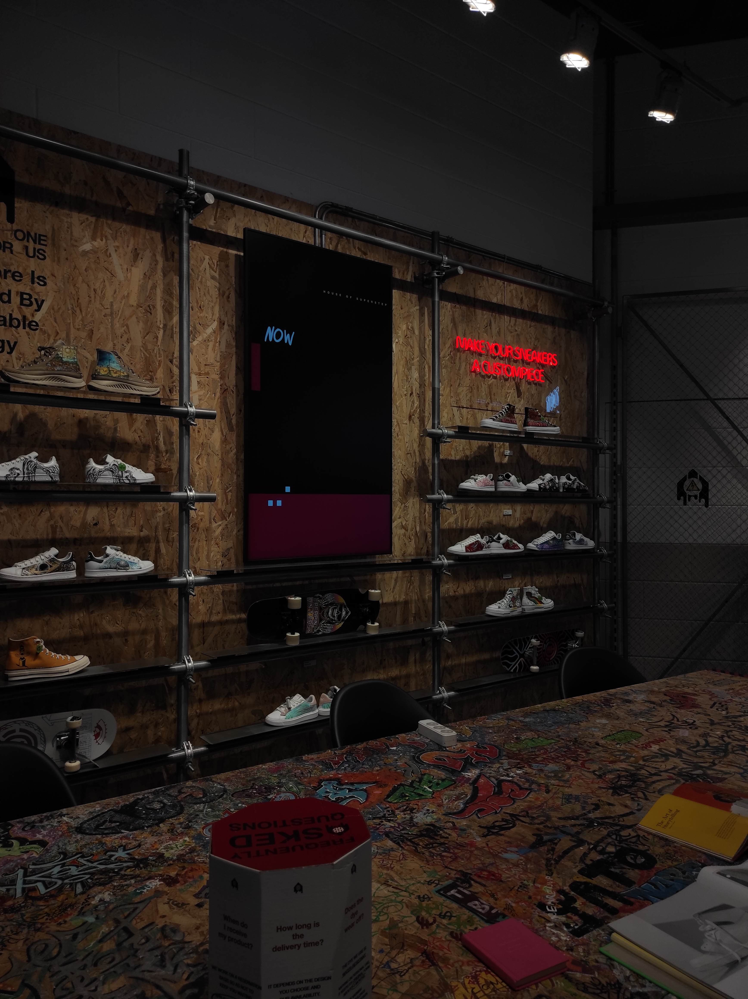

In [ ]:
#Fetch and display the image from GitHub.
url = 'https://github.com/ahmetkurtms/ceng391/blob/main/hw2.jpeg?raw=true'

response = urllib.request.urlopen(url) #Fetching the image.
image_array = np.asarray(bytearray(response.read()), dtype=np.uint8) #Convert it to a NumPy array
image = cv2.imdecode(image_array, cv2.IMREAD_COLOR)

cv2_imshow(image) # Use cv2_imshow to display the image in Colab

4. Before I convert the image into grayscale. I want to resize the image because it was cover all over the page.

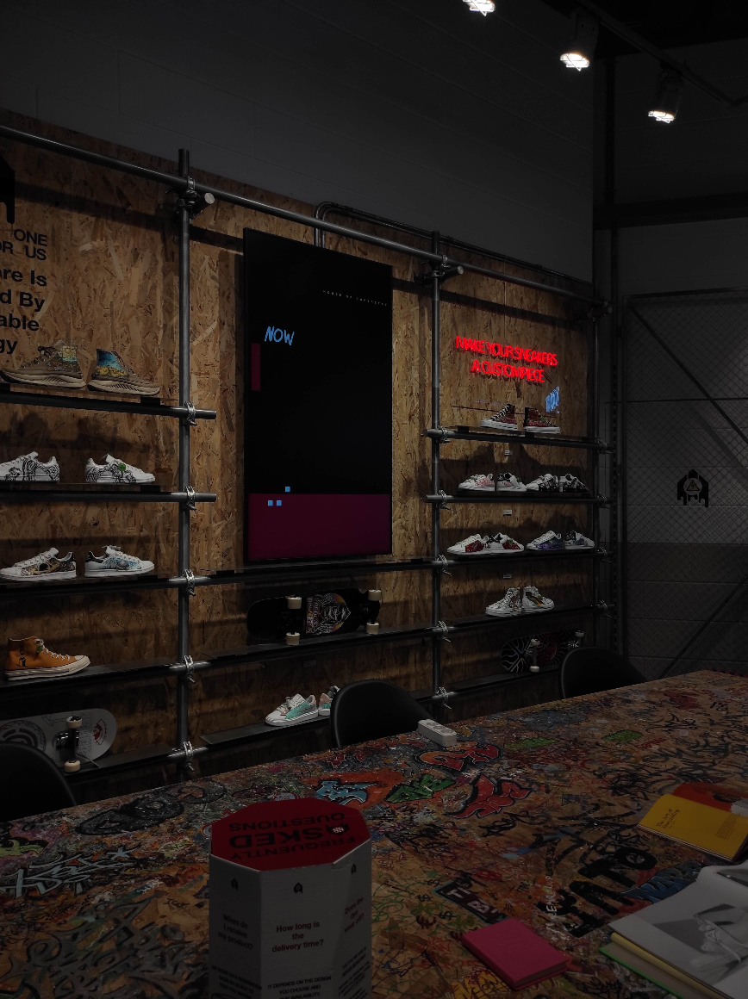

In [ ]:
resized_image = cv2.resize(image, (868, 1160))
cv2_imshow(resized_image)

5. And after that I converted the image into grayscale with openCV libraries.

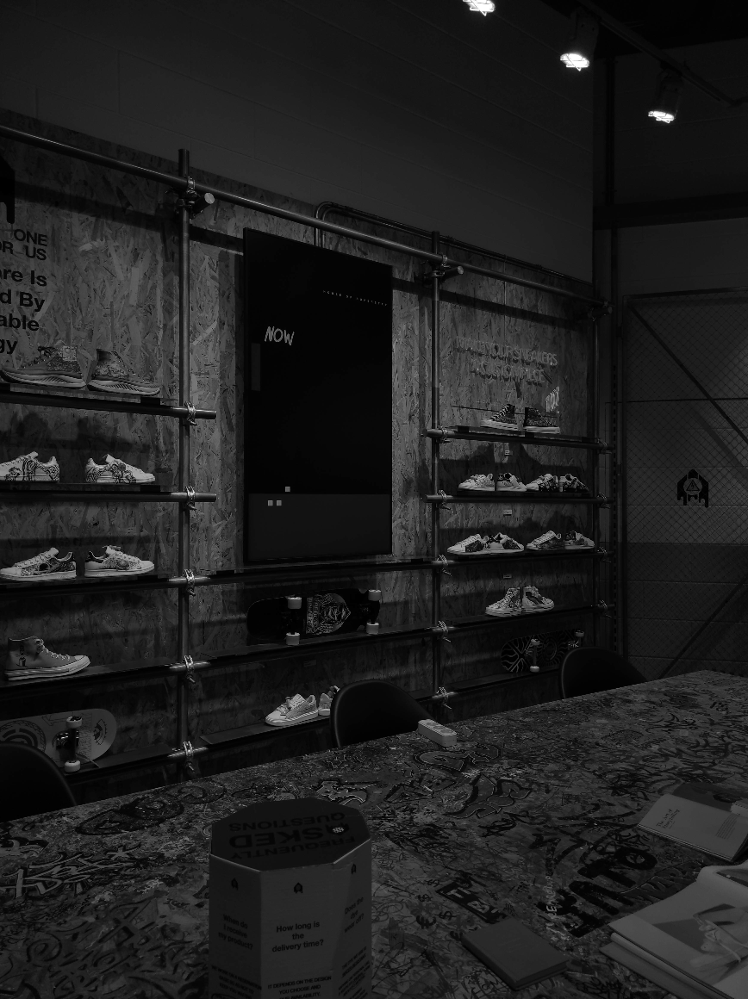

In [ ]:
gray_image = cv2.cvtColor(resized_image, cv2.COLOR_BGR2GRAY)
cv2_imshow(gray_image)

6. I defined a function for adding salt and pepper noises.

In [ ]:
def salt_and_pepper(image, prob):
    noisy_image = random_noise(image, mode='s&p', amount=prob) #salt & pepper noise with probability.

    noisy_image = np.array(255 * noisy_image, dtype=np.uint8) #Convert to uint8.

    return noisy_image

7. Appliyng the salt_and_pepper function and show the image.

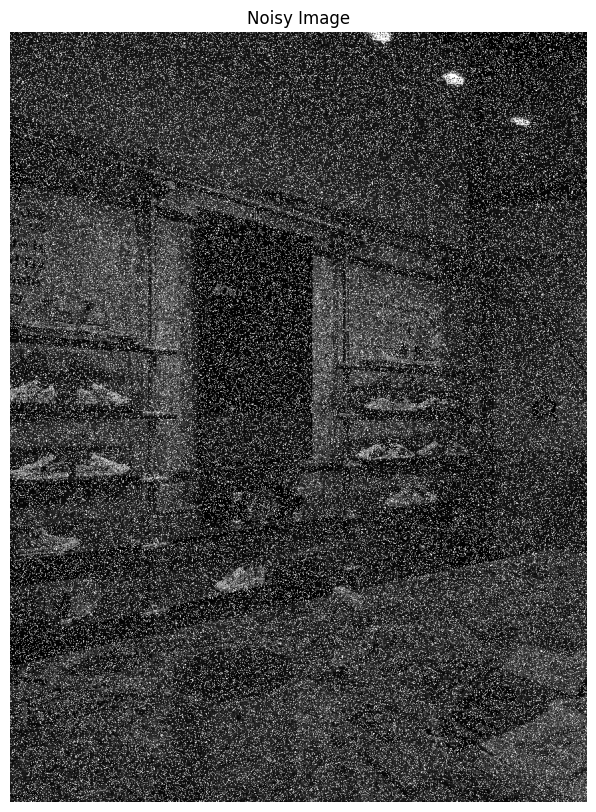

In [ ]:
noisy_image = salt_and_pepper(gray_image, prob=0.25) #Adding noise with a probability of 0.25

#Displaying the new image.
plt.figure(figsize=(20, 10))
plt.imshow(noisy_image, cmap='gray')
plt.title('Noisy Image')
plt.axis('off')
plt.show()

8. Applying median filtering with different kernel sizes and displaying the filtered images.


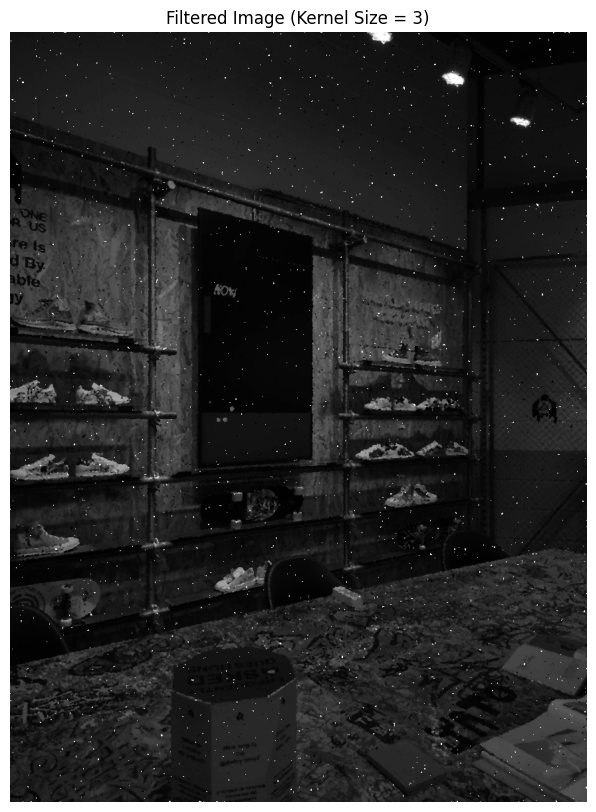

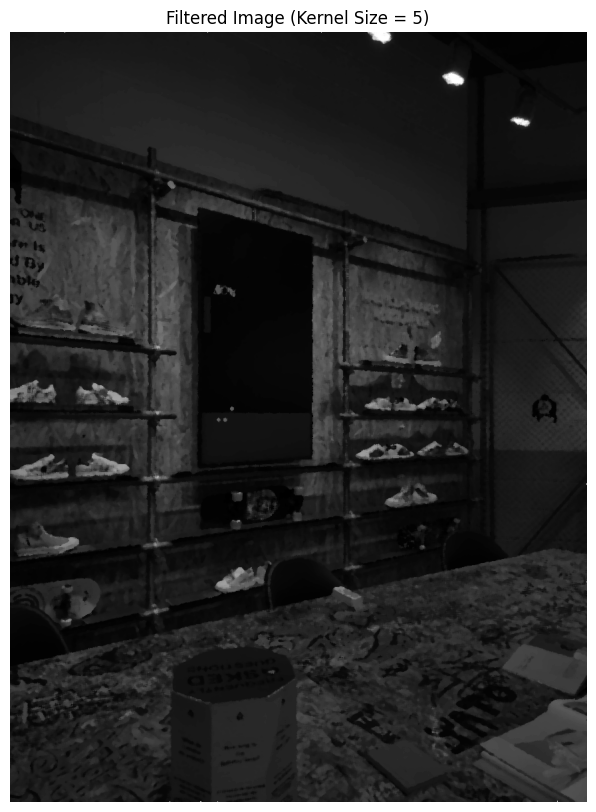

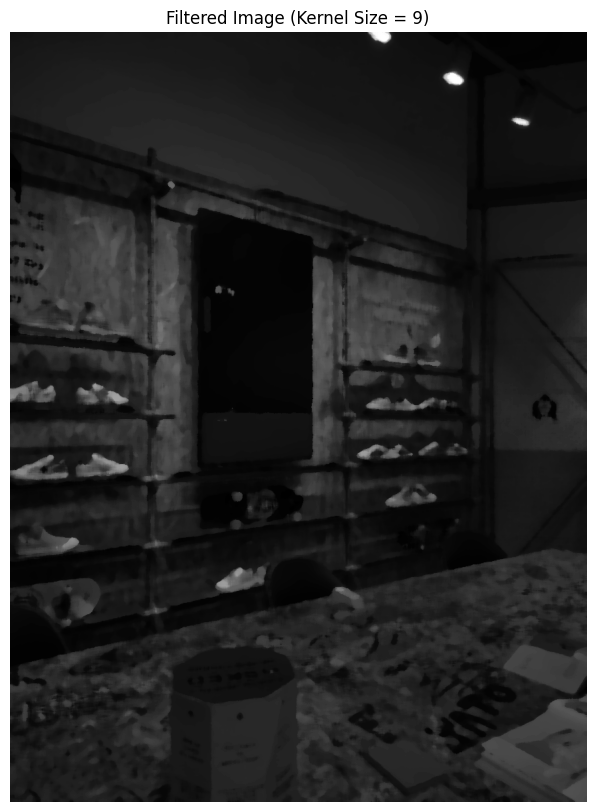

In [ ]:
#I choose kernel sizes 3,5 and 9.

#Kernel Size = 2
filtered_image_2 = cv2.medianBlur(noisy_image, 3)

plt.figure(figsize=(20, 10))
plt.imshow(filtered_image_2, cmap='gray')
plt.title('Filtered Image (Kernel Size = 3)')
plt.axis('off')
plt.show()


#Kernel Size = 5
filtered_image_5 = cv2.medianBlur(noisy_image, 5)

plt.figure(figsize=(20, 10))
plt.imshow(filtered_image_5, cmap='gray')
plt.title('Filtered Image (Kernel Size = 5)')
plt.axis('off')
plt.show()


#Kernel Size = 9
filtered_image_9 = cv2.medianBlur(noisy_image, 9)

plt.figure(figsize=(20, 10))
plt.imshow(filtered_image_9, cmap='gray')
plt.title('Filtered Image (Kernel Size = 9)')
plt.axis('off')
plt.show()

9. I applied 3 different median filtering to the image.

    *   Kernel Size 3: It would have been a good choic if the photo didn't have too much noise. But when I looked at the photo, I noticed that there are few pixels left.

    *   Kernel Size 5: I noticed more noise reduction but also slight blurring started to become noticeable. But still, the blur is good for kernel size 9.

    *   Kernel Size 9: This size removed a lot of noise but added as much blur. It can be effective when dealing with heavy noise photos.

  In summary, smaller kernels maintain details, while larger kernels remove more noise but make the image as much blurrier.



---




10. For the Robert's filters, we have 2 different matrix. I defined the matrixs and use cv2.filter2D method to apply Robert's filters.

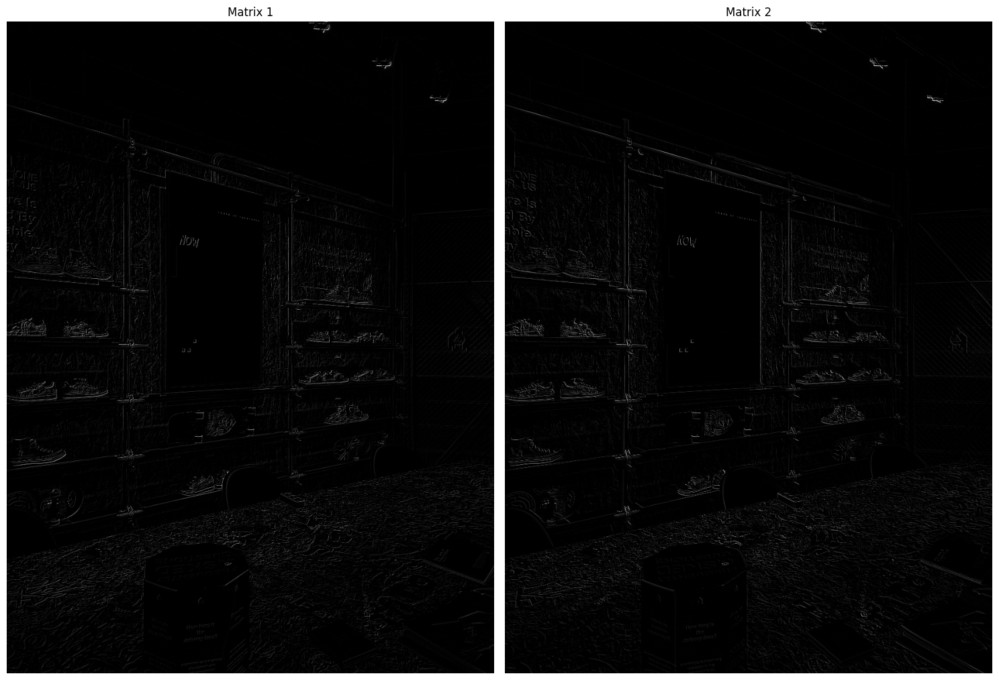

In [ ]:
kernel_1 = np.array([[1, 0], [0, -1]], dtype=np.float32)  # Top-left to Bottom-right
kernel_2 = np.array([[0, 1], [-1, 0]], dtype=np.float32)  # Top-right to Bottom-left

# Apply the Robert's filters in X and Y directions
roberts_1 = cv2.filter2D(gray_image, -1, kernel_1)
roberts_2 = cv2.filter2D(gray_image, -1, kernel_2)

# Display the results side-by-side for comparison
plt.figure(figsize=(15, 10))

plt.subplot(1, 2, 1)
plt.imshow(roberts_1, cmap='gray')
plt.title("Matrix 1")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(roberts_2, cmap='gray')
plt.title("Matrix 2")
plt.axis('off')

plt.tight_layout()
plt.show()


11. What kind of edges these filter detected?

  Robert's cross matrix is designed to detected diagonal edges. For example, given matrixs:

    *   Matrix 1 detects edges from the **top-left to the bottom-right** direction.
    *   Matrix 2 detects edges from the **top-right to the bottom left** direction.



---




12. I selected two different thresholds. First one is low and the second one is high. After that I displayed the images side-by-side.

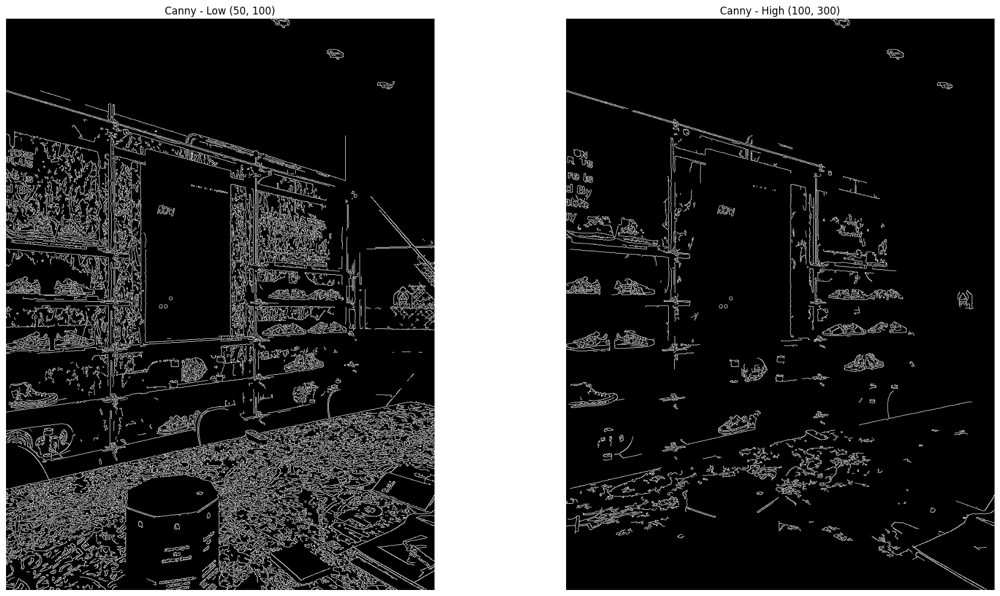

In [ ]:
# Low hysteresis thresholds
canny_low = cv2.Canny(gray_image, threshold1=50, threshold2=100)

# High hysteresis thresholds
canny_high = cv2.Canny(gray_image, threshold1=100, threshold2=300)

# Display the results side-by-side for comparison
plt.figure(figsize=(20, 10))

plt.subplot(1, 2, 1)
plt.imshow(canny_low, cmap='gray')
plt.title("Canny - Low (50, 100)")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(canny_high, cmap='gray')
plt.title("Canny - High (100, 300)")
plt.axis('off')

plt.tight_layout()
plt.show()


11. The Canny edge detector find edges with hysteresis thresholding. I choose two different inetrval.

    *   Low Thresholds (50, 100):
      *   This  set is more sensitive then high thresholds. It detected more edges with included weak ones.

    *   High Thresholds (100, 200):
      *   This set detected ostensible edges.
      *   However, it missed some weak corners according to the low thresholds set.

In summary, the lower thresholds set are useful when detecting all edges (weaker ones too). The high threshold sets are better for detecting more important edges.






In [ ]:
# End of the notebook.